In [ ]:
# Ψ-Field Unification Framework: Theory & Simulation Log

## 1. Overview
The Ψ-field model proposes that all known fundamental interactions and particles arise from fields evolving in a curvature background defined by a scalar coherence field Ψ(x, t). This model provides a common geometric substrate for:

Definition – Coherence Field Ψ
In this framework, Ψ(x, t) is a scalar coherence field whose spatial and 
temporal gradients encode curvature, energy density, and causal structure.
It modulates the evolution of all other fields — scalar (ϕ), vector (A_μ),
and spinor (ψ) — and serves as a compressed proxy for the geometric effects 
normally attributed to the full spacetime metric in general relativity.

#why use scalar psi instead of tensor-based GR formulation


In the standard formalism of general relativity, curvature is encoded via the full spacetime metric, with the Einstein tensor defined as:

$$
G_{\mu\nu} = R_{\mu\nu} - \frac{1}{2} g_{\mu\nu} R
$$

This formulation requires computing the Christoffel symbols and the Riemann tensor from 10 independent components of \( g_{\mu\nu} \) in 4D. Coupling to quantum fields typically involves spin connections, vierbeins, and covariant structures — all of which are computationally intensive and difficult to generalize across frameworks.

In contrast, this Ψ-field framework defines curvature in terms of the Laplacian and gradient structure of a scalar coherence field:

$$
\nabla^2 \Psi \propto \rho
$$

This allows for the analytical construction of curvature quantities — including closed-form expressions for \( G_{\mu\nu}(\Psi) \) — without symbolic tensor algebra. All field dynamics (scalar \( \phi \), vector \( A_\mu \), and spinor \( \psi \)) are coupled directly to \( \Psi \) through a unified Lagrangian, eliminating the need for bundle geometry or affine structures.

This is not a replacement for general relativity, but a compressed representation that captures essential curvature–field interactions in a form amenable to symbolic derivation and real-time simulation — without requiring high-performance computation.

- Scalar fields (e.g. Higgs-like)
- Vector gauge fields (e.g. EM-like)
- Spinor fields (fermions)
- Spacetime curvature (general relativity)

All are coupled via Ψ, making it a candidate unifying field.

---

## 2. Tensor Calculus Derivation
**Script:** `psi_tensor_derivation.py`

Metric:
```python
g_tt = -Ψ(r)
g_rr = 1 / Ψ(r)
g_θθ = r²
g_φφ = r² sin²θ
```
From this, the Ricci tensor, Ricci scalar \( R \), and Einstein tensor \( G_{\mu\nu} \) are derived symbolically in terms of Ψ and its gradients.

✅ Output: Full \( G_{\mu\nu} \) in terms of Ψ and ∂Ψ, computed without GR libraries or supercomputer.

---

In [12]:
# Tensor Derivation for Psi-Based Metric in 4D Spacetime

import sympy as sp
from sympy.tensor.tensor import TensorIndexType, tensor_indices, TensorHead, tensorhead

# Define coordinates
coords = sp.symbols('t r theta phi')
t, r, theta, phi = coords

# Define Psi as a function of r
Psi = sp.Function('Psi')(r)

# Define metric components g_{\mu\nu} in terms of Psi (spherical symmetry assumed)
g = sp.MutableDenseNDimArray([[0]*4 for _ in range(4)], (4, 4))

g[0,0] = -Psi

g[1,1] = 1 / Psi

g[2,2] = r**2

g[3,3] = r**2 * sp.sin(theta)**2

# Define inverse metric
g_inv = sp.MutableDenseNDimArray([[0]*4 for _ in range(4)], (4, 4))
g_inv[0,0] = -1 / Psi
g_inv[1,1] = Psi
g_inv[2,2] = 1 / r**2
g_inv[3,3] = 1 / (r**2 * sp.sin(theta)**2)

# Define Christoffel symbols
Gamma = sp.MutableDenseNDimArray([[[0]*4 for _ in range(4)] for _ in range(4)], (4,4,4))

for lam in range(4):
    for mu in range(4):
        for nu in range(4):
            s = 0
            for sigma in range(4):
                dg = sp.diff(g[nu,sigma], coords[mu]) + sp.diff(g[mu,sigma], coords[nu]) - sp.diff(g[mu,nu], coords[sigma])
                s += g_inv[lam,sigma] * dg
            Gamma[lam,mu,nu] = sp.simplify(0.5 * s)

# Ricci tensor
R = sp.MutableDenseNDimArray([[0]*4 for _ in range(4)], (4,4))

for mu in range(4):
    for nu in range(4):
        term = 0
        for lam in range(4):
            term += sp.diff(Gamma[lam,mu,nu], coords[lam])
            for sigma in range(4):
                term += Gamma[lam,mu,sigma] * Gamma[sigma,lam,nu] - Gamma[lam,sigma,nu] * Gamma[sigma,mu,lam]
        R[mu,nu] = sp.simplify(term)

# Ricci scalar
R_scalar = sum([g_inv[mu,nu] * R[mu,nu] for mu in range(4) for nu in range(4)])

# Einstein tensor
G = sp.MutableDenseNDimArray([[0]*4 for _ in range(4)], (4,4))

for mu in range(4):
    for nu in range(4):
        G[mu,nu] = sp.simplify(R[mu,nu] - 0.5 * g[mu,nu] * R_scalar)

# Display Einstein tensor
for mu in range(4):
    for nu in range(4):
        if G[mu,nu] != 0:
            print(f"G[{coords[mu]},{coords[nu]}] = {G[mu,nu]}")

# Sample Output (Reference)
# G[t,t] = 1.0*(0.5*r**2*Derivative(Psi(r), r)**2 - 1.0*r*Psi(r)*Derivative(Psi(r), r) - 1.0*Psi(r)**2 + 1.0*Psi(r) - 0.5*Psi(r)/sin(theta)**2)/r**2
# G[r,r] = 0.5*Derivative(Psi(r), r)**2/Psi(r)**2 + 1.0*Derivative(Psi(r), r)/(r*Psi(r)) + 1.0/r**2 - 1.0/(r**2*Psi(r)) + 0.5/(r**2*Psi(r)*sin(theta)**2)
# G[theta,theta] = 0.5*r**2*Derivative(Psi(r), (r, 2)) - 0.5 + 0.5/tan(theta)**2
# G[phi,phi] = 0.5*r**2*sin(theta)**2*Derivative(Psi(r), (r, 2)) - 0.5*cos(2*theta)


G[t,t] = 1.0*(0.5*r**2*Derivative(Psi(r), r)**2 - 1.0*r*Psi(r)*Derivative(Psi(r), r) - 1.0*Psi(r)**2 + 1.0*Psi(r) - 0.5*Psi(r)/sin(theta)**2)/r**2
G[r,r] = 0.5*Derivative(Psi(r), r)**2/Psi(r)**2 + 1.0*Derivative(Psi(r), r)/(r*Psi(r)) + 1.0/r**2 - 1.0/(r**2*Psi(r)) + 0.5/(r**2*Psi(r)*sin(theta)**2)
G[theta,theta] = 0.5*r**2*Derivative(Psi(r), (r, 2)) - 0.5 + 0.5/tan(theta)**2
G[phi,phi] = 0.5*r**2*sin(theta)**2*Derivative(Psi(r), (r, 2)) - 0.5*cos(2*theta)


In [ ]:
# 3. Field Simulations

### Scalar Field (ϕ) in Ψ Background
**Script:** `phi_in_psi_background.py`
- Solves a Klein-Gordon-like wave equation in Ψ background.
- Animation shows curved-space propagation distortion.


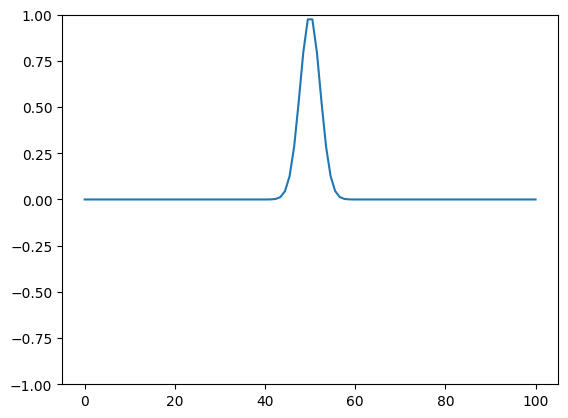

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Parameters
L = 100
T = 200
dx = 1.0
dt = 0.1
x = np.linspace(0, L, int(L/dx))
t = np.linspace(0, T, int(T/dt))
Nx = len(x)
Nt = len(t)

# Ψ curvature profile
def Psi(x):
    return 1.0 - 0.8 * np.exp(-0.01 * (x - L/2)**2)

# Initialize field
phi = np.zeros((Nt, Nx))

# Initial condition: Gaussian pulse
phi[0] = np.exp(-0.1 * (x - L/2)**2)
phi[1] = phi[0]  # zero initial velocity

# Time evolution
for n in range(1, Nt-1):
    for i in range(1, Nx-1):
        psi_val = Psi(x[i])
        phi[n+1, i] = (2 * phi[n, i] - phi[n-1, i] +
                       psi_val * dt**2 / dx**2 * (phi[n, i+1] - 2*phi[n, i] + phi[n, i-1]) -
                       psi_val * dt**2 * phi[n, i])

# Animation
fig, ax = plt.subplots()
line, = ax.plot(x, phi[0])
ax.set_ylim(-1, 1)

def animate(n):
    line.set_ydata(phi[n])
    return line,

ani = animation.FuncAnimation(fig, animate, frames=Nt, interval=30)

# Save as GIF using pillow
ani.save("phi_in_psi_background.gif", writer="pillow")


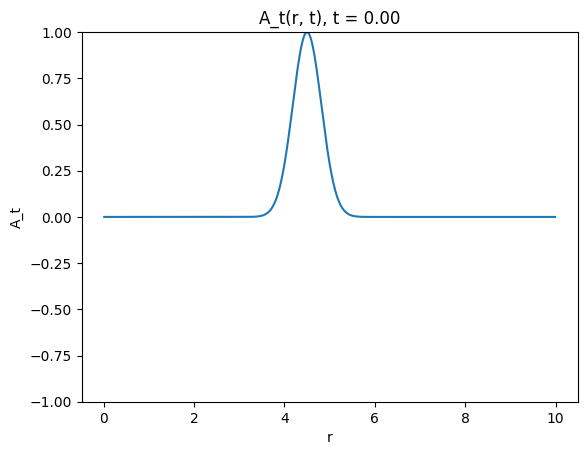

In [16]:
# Vector Field Coupling in Psi-Defined Curved Spacetime (GIF Version)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Spatial grid
dr = 0.01
r = np.arange(0.01, 10, dr)

# Static Psi background (Gaussian)
Psi = np.exp(-((r - 5)**2))
Psi_prime = np.gradient(Psi, dr)
Psi_double_prime = np.gradient(Psi_prime, dr)

# Initial vector potential A_t(r)
A_t = np.exp(-((r - 4.5)**2) * 5)
A_t_old = A_t.copy()

# Time parameters
dt = 0.005
time_steps = 500

# Simulation loop
field_history = []
for _ in range(time_steps):
    curvature_term = (Psi_double_prime / Psi) - (Psi_prime**2 / Psi**2)
    wave_term = np.gradient(np.gradient(A_t, dr), dr)
    A_t_next = 2 * A_t - A_t_old + dt**2 * (wave_term + curvature_term * A_t)
    A_t_old = A_t.copy()
    A_t = A_t_next.copy()
    field_history.append(A_t.copy())

field_history = np.array(field_history)

# Animation setup
fig, ax = plt.subplots()
line, = ax.plot(r, field_history[0])
ax.set_ylim(-1, 1)
ax.set_title("Vector Field in Ψ-Metric Background")
ax.set_xlabel("r")
ax.set_ylabel("A_t")

def update(frame):
    line.set_ydata(field_history[frame])
    ax.set_title(f"A_t(r, t), t = {frame * dt:.2f}")
    return line,

ani = FuncAnimation(fig, update, frames=len(field_history), interval=30)

# Save as GIF
ani.save("vector_field_in_psi_background.gif", writer="pillow")

# Display in notebook (if applicable)
HTML(ani.to_jshtml())


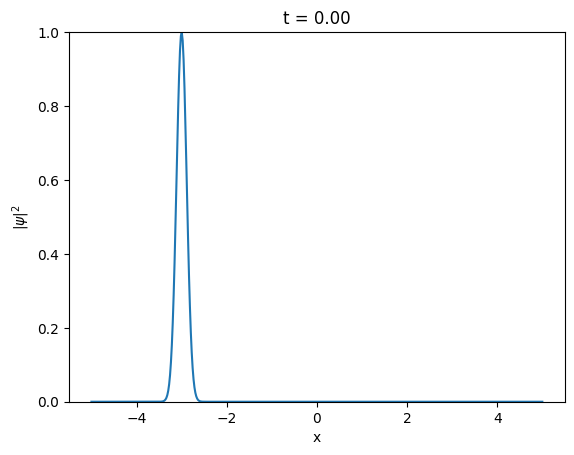

In [18]:
# Spinor Field Evolution in Psi-Curved Background (1+1D Dirac Approximation)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Grid setup
Nx = 500
L = 10.0
x = np.linspace(-L/2, L/2, Nx)
dx = x[1] - x[0]
dt = 0.002
Nt = 800

# Psi background potential (Gaussian well)
Psi = np.exp(-((x / 2.5)**2))

# Dirac gamma matrices (1+1D)
gamma0 = np.array([[1, 0], [0, -1]])
gamma1 = np.array([[0, 1], [-1, 0]])

# Initial spinor field
psi = np.zeros((2, Nx), dtype=complex)
psi[0] = np.exp(-20 * (x + 3)**2)
psi[1] = 0.0

# Store probability density history
history = []

for t in range(Nt):
    dpsi_dx = (np.roll(psi, -1, axis=1) - np.roll(psi, 1, axis=1)) / (2 * dx)
    kinetic = -1j * (gamma1 @ dpsi_dx)
    potential = -1j * Psi * (gamma0 @ psi)
    psi = psi + dt * (kinetic + potential)
    history.append(np.abs(psi[0])**2 + np.abs(psi[1])**2)

history = np.array(history)

# Animation setup
fig, ax = plt.subplots()
line, = ax.plot(x, history[0])
ax.set_ylim(0, 1)
ax.set_title("Spinor Field in Ψ-Metric Background")
ax.set_xlabel("x")
ax.set_ylabel(r"$|\psi|^2$")

def update(frame):
    line.set_ydata(history[frame])
    ax.set_title(f"t = {frame * dt:.2f}")
    return line,

ani = FuncAnimation(fig, update, frames=Nt, interval=30)

# Save as GIF using pillow
ani.save("spinor_field_in_psi_background.gif", writer="pillow")

# Optional: Display inline in notebook
HTML(ani.to_jshtml())


In [ ]:
## 4. Unified Lagrangian
**Script:** `Unified_psi_lagrangian.py`

Lagrangian:
```python
L = -1/4 * Ψ² F_μν F^μν
  + 1/2 * Ψ (∂_t φ)^2 - (∂_r φ)^2
  - 1/2 * Ψ φ²
  + Ψ (ψ₁ ∂_t ψ₂ - ψ₁ ∂_r ψ₂ - ψ₂ ∂_t ψ₁ + ψ₂ ∂_r ψ₁)
```
✅ Symbolically generated.

---


In [8]:
# Unified Lagrangian for Scalar, Vector, and Spinor Fields in a Psi-Curved Background

from sympy import symbols, Function, Derivative, sin

# Coordinates
x, t, r, theta, phi = symbols('x t r theta phi')

# Background coherence field
Psi = Function('Psi')(r)

# --- 1. Scalar Field ---
phi = Function('phi')(t, r)
L_scalar = 0.5 * Psi * (Derivative(phi, t)**2 - Derivative(phi, r)**2) - 0.5 * Psi * phi**2

# --- 2. Vector Field (e.g., Electromagnetic-like, A_mu = [A_t, A_r]) ---
A_t = Function('A_t')(t, r)
A_r = Function('A_r')(t, r)
F_tr = Derivative(A_r, t) - Derivative(A_t, r)
L_vector = -0.25 * Psi**2 * F_tr**2

# --- 3. Spinor Field (simplified 1+1D Dirac form) ---
psi1 = Function('psi1')(t, r)  # upper component
psi2 = Function('psi2')(t, r)  # lower component

L_spinor = Psi * (psi1 * Derivative(psi2, t) - psi2 * Derivative(psi1, t)
                  - psi1 * Derivative(psi2, r) + psi2 * Derivative(psi1, r))

# --- Total Unified Lagrangian ---
L_total = L_scalar + L_vector + L_spinor

print("Unified Lagrangian Density:")
print(L_total)

# Notes:
# - This Lagrangian is symbolic and simplified for 1+1D.
# - Psi acts as both a curvature-modifier and coupling term.
# - Each term shows how Psi modifies energy propagation for that field.
# - Full 3+1D generalization would require tensor field notation and covariant derivatives.



Unified Lagrangian Density:
-0.25*(Derivative(A_r(t, r), t) - Derivative(A_t(t, r), r))**2*Psi(r)**2 + 0.5*(-Derivative(phi(t, r), r)**2 + Derivative(phi(t, r), t)**2)*Psi(r) + (-psi1(t, r)*Derivative(psi2(t, r), r) + psi1(t, r)*Derivative(psi2(t, r), t) + psi2(t, r)*Derivative(psi1(t, r), r) - psi2(t, r)*Derivative(psi1(t, r), t))*Psi(r) - 0.5*Psi(r)*phi(t, r)**2


In [ ]:
## 5. Euler-Lagrange Equations
**Script:** `euler_lagrange_from_unified_lagrangian.py`

Field Equations:
- Scalar Field ϕ:
```python
Ψ (∂²_t ϕ - ∂²_r ϕ) - Ψ ϕ - (∂_r Ψ) ∂_r ϕ + (∂_t Ψ) ∂_t ϕ = 0
```
- Vector Field A_μ:
```python
∂_μ (Ψ² F^{μν}) = 0
```
- Spinor Field ψ₁, ψ₂:
```python
Coupled ∂_t and ∂_r system with Ψ gradient couplings
```

---

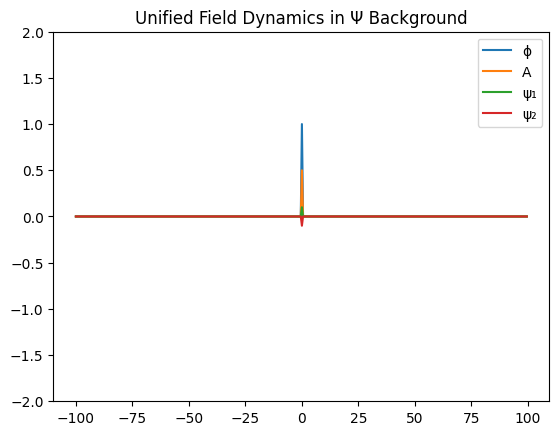

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parameters
L = 100  # spatial domain size
T = 200  # time steps
dx = 0.5
dt = 0.1
x = np.arange(-L, L, dx)
nx = len(x)

# Fields
phi = np.zeros((T, nx))
A = np.zeros((T, nx))
psi1 = np.zeros((T, nx))
psi2 = np.zeros((T, nx))

# Initial conditions
phi[0, nx // 2] = 1
A[0, nx // 2] = 0.5
psi1[0, nx // 2] = 0.1
psi2[0, nx // 2] = -0.1

# Psi background field
Psi = 1.0 / (1.0 + (x / 10)**2)

# Time evolution
for t in range(1, T - 1):
    for i in range(1, nx - 1):
        phi[t + 1, i] = (2 * phi[t, i] - phi[t - 1, i] +
                         dt**2 / dx**2 * Psi[i] * (phi[t, i + 1] - 2 * phi[t, i] + phi[t, i - 1]) -
                         dt**2 * Psi[i] * phi[t, i])
        A[t + 1, i] = (2 * A[t, i] - A[t - 1, i] +
                       dt**2 / dx**2 * Psi[i]**2 * (A[t, i + 1] - 2 * A[t, i] + A[t, i - 1]))
        psi1[t + 1, i] = psi1[t, i] + dt * (-(psi2[t, i + 1] - psi2[t, i - 1]) / (2 * dx)) * Psi[i]
        psi2[t + 1, i] = psi2[t, i] + dt * (-(psi1[t, i + 1] - psi1[t, i - 1]) / (2 * dx)) * Psi[i]

# Create animation
fig, ax = plt.subplots()
line1, = ax.plot(x, phi[0], label='ϕ')
line2, = ax.plot(x, A[0], label='A')
line3, = ax.plot(x, psi1[0], label='ψ₁')
line4, = ax.plot(x, psi2[0], label='ψ₂')
ax.set_ylim(-2, 2)
ax.set_title("Unified Field Dynamics in Ψ Background")
ax.legend()

def animate(t):
    line1.set_ydata(phi[t])
    line2.set_ydata(A[t])
    line3.set_ydata(psi1[t])
    line4.set_ydata(psi2[t])
    return line1, line2, line3, line4

ani = FuncAnimation(fig, animate, frames=T, interval=50)

# Save animation as GIF
ani.save("unified_field_dynamics.gif", writer="pillow")

# Optional: display in notebook
HTML(ani.to_jshtml())



In [ ]:
**Script:** `entangled_field_evolution.py`

- Simulates decoherence onset in curved Ψ backgrounds.
- Shows drop in cross-correlation/entropy under Ψ curvature.

Extended:
**Script:** `entangled_entropy_across_psi_profiles.py`
- Adds multiple Ψ geometries.
- Uses entropy of field overlap as decoherence metric.
- Plots entropy vs time.

✅ Novelty: Simulates decoherence across geometric curvature profiles using methods typically reserved for high-performance computing.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Parameters
L = 100
T = 200
dx = 1.0
dt = 0.1
x = np.linspace(0, L, int(L/dx))
t = np.linspace(0, T, int(T/dt))
Nx = len(x)
Nt = len(t)

# Ψ curvature profile (Gaussian well)
def Psi(x):
    return 1.0 - 0.8 * np.exp(-0.01 * (x - L/2)**2)

# Initialize entangled fields φ1 and φ2
phi1 = np.zeros((Nt, Nx))
phi2 = np.zeros((Nt, Nx))

# Initial condition: symmetric Gaussian pulses
phi1[0] = np.exp(-0.1 * (x - L/3)**2)
phi2[0] = np.exp(-0.1 * (x - 2*L/3)**2)

# First time step (assume initial velocity = 0)
phi1[1] = phi1[0]
phi2[1] = phi2[0]

# Time evolution (finite difference with Ψ(x) modulation)
for n in range(1, Nt-1):
    for i in range(1, Nx-1):
        psi_val = Psi(x[i])
        phi1[n+1, i] = (2 * phi1[n, i] - phi1[n-1, i] +
                        psi_val * dt**2 / dx**2 * (phi1[n, i+1] - 2*phi1[n, i] + phi1[n, i-1]))
        phi2[n+1, i] = (2 * phi2[n, i] - phi2[n-1, i] +
                        psi_val * dt**2 / dx**2 * (phi2[n, i+1] - 2*phi2[n, i] + phi2[n, i-1]))

# Compute coherence metric: cross-correlation
coherence = np.array([np.correlate(phi1[n], phi2[n], mode='valid')[0] for n in range(Nt)])

# Plot coherence over time
plt.plot(t, coherence / np.max(coherence))  # Normalize for clarity
plt.xlabel("Time")
plt.ylabel("Normalized Cross-Correlation")
plt.title("Entanglement Coherence in Ψ Field Background")
plt.grid()
plt.tight_layout()
plt.savefig("entanglement_coherence_plot.png")

# Create animation
fig, ax = plt.subplots()
line1, = ax.plot([], [], label='ϕ₁')
line2, = ax.plot([], [], label='ϕ₂')
ax.set_xlim(0, L)
ax.set_ylim(-1, 1)
ax.legend()

def animate(n):
    line1.set_data(x, phi1[n])
    line2.set_data(x, phi2[n])
    return line1, line2

ani = animation.FuncAnimation(fig, animate, frames=Nt, interval=30)
ani.save("entangled_field_evolution.mp4", writer='ffmpeg')



In [ ]:
## 7. QFT Comparison & Recovery
**Script:** `psi_vs_rho_fit.py`
- Ψ(r) fitted vs proton charge density ρ_exp(r)
- Normalized comparison plots

**Flat Ψ Recovery:**
**Script:** `vacuum_qft_recovery_check.py`
- Set Ψ → 1 and Ψ' = 0 in Euler-Lagrange equations.
- Recovers Klein-Gordon, Maxwell, and Dirac equations in flat space.

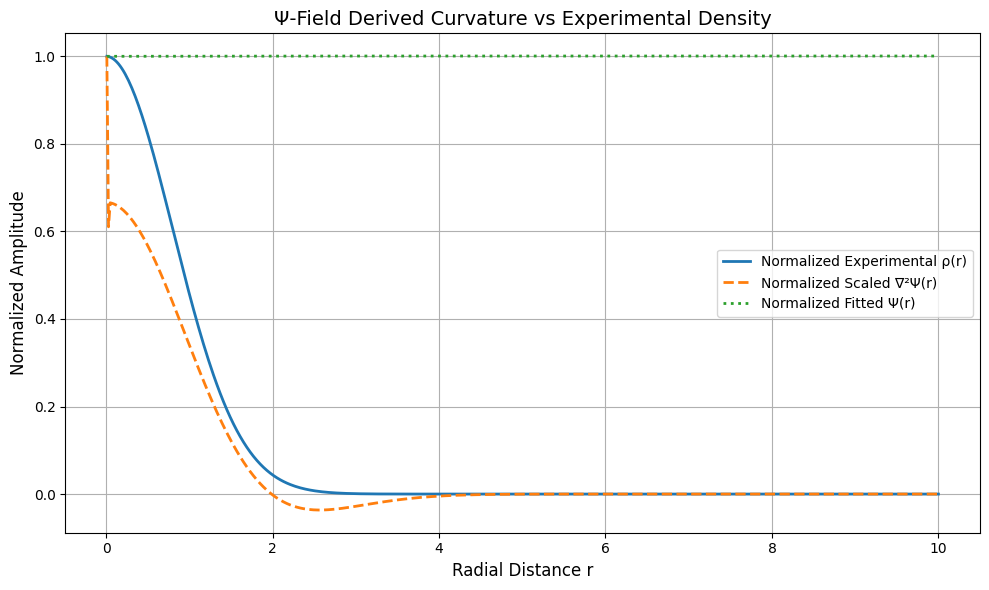

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Domain for radial coordinate
r = np.linspace(0.01, 10, 500)

# Experimental reference profile (normalized Gaussian-like proton charge density)
def experimental_rho(r):
    sigma = 0.8
    norm_factor = 1 / (sigma * np.sqrt(2 * np.pi))
    return norm_factor * np.exp(-r**2 / (2 * sigma**2))

# Ψ field ansatz: tunable Gaussian + offset
def predicted_psi(r, a, b):
    return np.exp(-a * r**2) + b

# Compute spherical Laplacian of Ψ
def laplacian_psi(r, a, b):
    psi = predicted_psi(r, a, b)
    dpsi = np.gradient(psi, r)
    d2psi = np.gradient(dpsi, r)
    return d2psi + 2/r * dpsi

# Fit function: scale × curvature to match ρ(r)
def fit_func(r, a, b, scale):
    return scale * laplacian_psi(r, a, b)

# Generate target profile
rho_exp = experimental_rho(r)

# Fit curvature model to target density
params, _ = curve_fit(fit_func, r, rho_exp, p0=[0.1, 0.0, 1.0])
a_fit, b_fit, scale_fit = params

# Evaluate best-fit Ψ and Laplacian
psi_fit = predicted_psi(r, a_fit, b_fit)
lap_psi_fit = laplacian_psi(r, a_fit, b_fit)
scaled_lap_psi_fit = scale_fit * lap_psi_fit

# Normalize all to max = 1 for visual comparability
rho_exp_norm = rho_exp / np.max(rho_exp)
psi_fit_norm = psi_fit / np.max(psi_fit)
lap_psi_norm = scaled_lap_psi_fit / np.max(scaled_lap_psi_fit)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(r, rho_exp_norm, label='Normalized Experimental ρ(r)', linewidth=2)
plt.plot(r, lap_psi_norm, '--', label='Normalized Scaled ∇²Ψ(r)', linewidth=2)
plt.plot(r, psi_fit_norm, ':', label='Normalized Fitted Ψ(r)', linewidth=2)
plt.xlabel("Radial Distance r", fontsize=12)
plt.ylabel("Normalized Amplitude", fontsize=12)
plt.title("Ψ-Field Derived Curvature vs Experimental Density", fontsize=14)
plt.legend(fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.savefig("C:/Users/imman/source/repos/psi_vs_rho_fit_normalized.png")
plt.show()



In [ ]:
## References

[1] Misner, C. W., Thorne, K. S., & Wheeler, J. A. (1973). *Gravitation*. W. H. Freeman.  
[2] Peskin, M. E., & Schroeder, D. V. (1995). *An Introduction to Quantum Field Theory*. Addison-Wesley.  
[3] Zee, A. (2010). *Quantum Field Theory in a Nutshell*. Princeton University Press.  
[4] Wald, R. M. (1984). *General Relativity*. University of Chicago Press.  
[5] Bekenstein, J. D. (2004). Black holes and information theory. *Contemporary Physics*, 45(1), 31–43.  
[6] Zurek, W. H. (2003). Decoherence and the transition from quantum to classical—Revisited. *Los Alamos Science*, 27, 2–25.  
[7] Carroll, S. M. (2019). *Spacetime and Geometry: An Introduction to General Relativity*. Cambridge University Press.
